The goal here is to train ONE RBM, then I will use similar code to do hyperparametric search.

In [116]:
# Activate project
using Pkg
Pkg.activate("/Users/alessiogiorlandino/Desktop/SAM/Project.toml")
Base.active_project()
# Resolve dependencies
Pkg.resolve()

  Activating project at `~/Desktop/SAM`
  No Changes to `~/Desktop/SAM/Project.toml`
  No Changes to `~/Desktop/SAM/Manifest.toml`


In [117]:
import Rfam, Infernal, Logomaker, FASTX
using Optimisers: Adam
using EllipsisNotation: (..)
using FillArrays: Falses
import Makie, CairoMakie
using Makie: @colorant_str
import SamApp
using LinearAlgebra
using Statistics

In [118]:
using BioSequences: LongRNA, @rna_str
using Statistics: mean, std, cor
import JLD2

import RestrictedBoltzmannMachines as RBMs
import CudaRBMs, CenteredRBMs
using CudaRBMs: gpu, cpu
using CenteredRBMs: CenteredRBM, center, uncenter, center_from_data!
using RestrictedBoltzmannMachines: initialize!, RBM, xReLU, Potts, pcd!, Binary, log_pseudolikelihood, free_energy
using RBMsAnnealedImportanceSampling: aise, raise, logmeanexp, logstdexp, logvarexp

using MiniLoggers: global_logger, MiniLogger
global_logger(MiniLogger());

# Load sequence data from Rfam

In [119]:
cm = Infernal.cmfetch(Rfam.cm(), "RF00162")
natural_seed_stk = Infernal.esl_afetch(Rfam.seed(), "RF00162");
natural_seed_afa = Infernal.esl_reformat("afa", natural_seed_stk.out);
natural_seed_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_seed_afa.out)));

# Consensus secondary structure in WUSS format
seed_wuss = SamApp.stockholm_ss(natural_seed_stk.out)
seed_match_positions = findall(c -> c ≠ '.' && c ≠ '~', seed_wuss);

natural_hits_afa = Infernal.cmalign(Infernal.cmfetch(Rfam.cm(), "RF00162").out, Rfam.fasta_file("RF00162"); outformat="afa");
natural_hits_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_hits_afa.out)));

In [120]:
natural_seed_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_seed_afa.out))) do record
    FASTX.sequence(record)[seed_match_positions]
end

natural_hits_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_hits_afa.out))) do record
    filter(c -> !islowercase(c) && c ≠ '.', FASTX.sequence(record))
end

@assert only(unique(length.(natural_seed_sequences_matchonly))) == length(seed_match_positions) == 108
@assert only(unique(length.(natural_hits_sequences_matchonly))) == length(seed_match_positions) == 108

In [121]:
data_hits = SamApp.onehot(LongRNA{4}.(natural_hits_sequences_matchonly));

In [122]:
SamApp.seqlogo_entropic(reshape(mean(data_hits; dims=3), 5, 108)).fig

PythonCall.PyException: Python: UnicodeEncodeError: 'ascii' codec can't encode character '\u229f' in position 21: ordinal not in range(128)

In [123]:
#SamApp.rf00162_seed_taxonomy()

In [124]:
#SamApp.rf00162_hits_taxonomy()

# PCA

In [125]:
data_shape = size(data_hits)
data_flatten = reshape(data_hits, (data_shape[1]*data_shape[2], data_shape[3]))
data_flatten_cov = cov(data_flatten, dims=2)
cov_eigenval = eigvals(data_flatten_cov)
expl_ratio = cov_eigenval/sum(cov_eigenval)
ort_trasf = eigvecs(data_flatten_cov)

540×540 Matrix{Float64}:
 -0.00500608  -0.00373539   0.00116988   …  -0.024502     -0.0279693
 -0.00500608  -0.00373539   0.00116988       0.00386802    0.0372477
 -0.00500608  -0.00373539   0.00116988      -0.024368     -0.0346185
 -0.00500608  -0.00373539   0.00116988       0.0450736     0.0258592
 -0.00500608  -0.00373539   0.00116988      -7.56379e-5   -0.000531111
  0.0250623    0.0397066   -0.0148391    …  -0.0204701    -0.068204
  0.0250623    0.0397066   -0.0148391        0.00704773   -0.0224542
  0.0250623    0.0397066   -0.0148391       -0.0891822    -0.043177
  0.0250623    0.0397066   -0.0148391        0.102815      0.134019
  0.0250623    0.0397066   -0.0148391       -0.000214233  -0.000195645
  ⋮                                      ⋱                
 -0.15687     -0.0205068   -0.0538109       -0.0236288    -0.0134448
 -0.15687     -0.0205068   -0.0538109       -0.0325534    -0.05601
 -0.15687     -0.0205068   -0.0538109       -0.0538271    -0.0315493
 -0.15687     -0.020

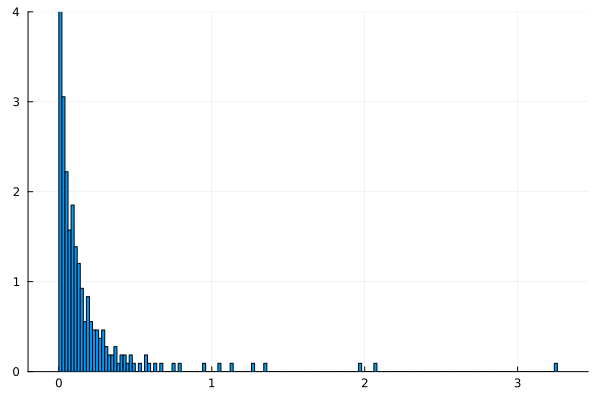

In [126]:
function set_negative_to_zero(arr)
    for i in 1:length(arr)
        if arr[i] < 0
            arr[i] = 0
        end
    end
    return arr
end

cov_eigenval = set_negative_to_zero(cov_eigenval)
using Plots
histogram(cov_eigenval, normalize=:pdf, ylim=(0,4), legend=false)
# add upper threshold for Marcenko-Pastur Distribution

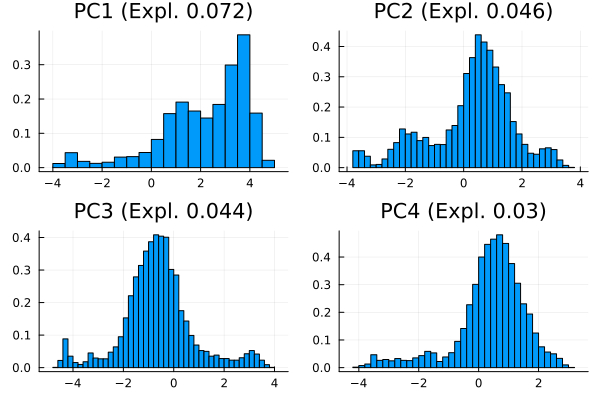

In [127]:
# First Component Histogram 
data_flatten_rot = transpose(ort_trasf)*data_flatten
pc1 = data_flatten_rot[end, :]
p1=histogram(pc1, normalize=:pdf, title=("PC1 (Expl. $(round(expl_ratio[end], digits=3)))"))


pc2 = data_flatten_rot[end-1, :]
p2=histogram(pc2, normalize=:pdf, title=("PC2 (Expl. $(round(expl_ratio[end-1], digits=3)))"))

pc3 = data_flatten_rot[end-2, :]
p3=histogram(pc3, normalize=:pdf, title=("PC3 (Expl. $(round(expl_ratio[end-2], digits=3)))"))

pc4 = data_flatten_rot[end-3, :]
p4=histogram(pc4, normalize=:pdf, title=("PC4 (Expl. $(round(expl_ratio[end-3], digits=3)))"))


plot(p1, p2, p3, p4, layout=(2,2), legend=false)

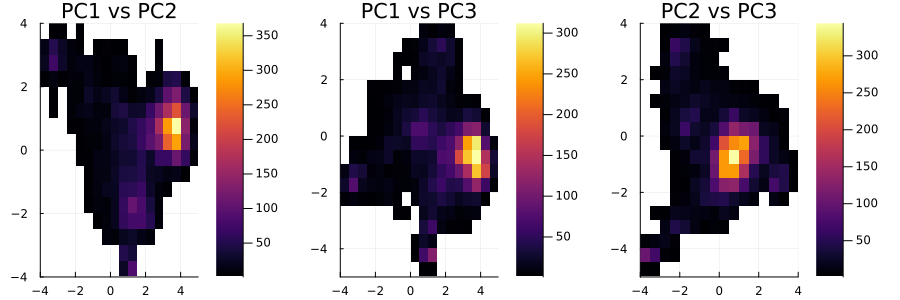

In [128]:
p1=histogram2d(pc1, pc2, title="PC1 vs PC2")
p2=histogram2d(pc1, pc3, title="PC1 vs PC3")
p3=histogram2d(pc2, pc3, title="PC2 vs PC3")

plot(p1, p2, p3, layout=(1,3), legend=false, size=(900,300))

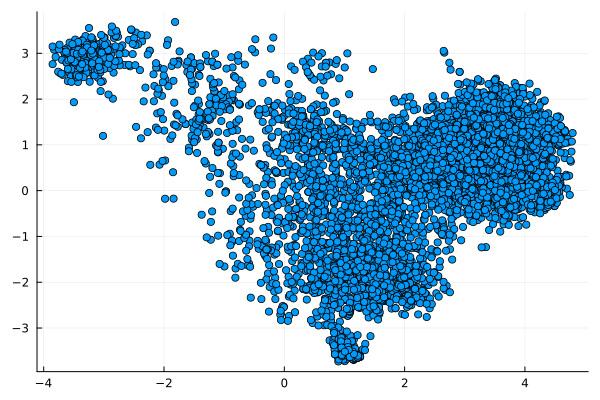

In [129]:
scatter(pc1, pc2, legend=false)

# Train RBM

In [130]:
# Sparsity parameter, as defined in Tubiana, RM, 2017 PRL (denoted \hat{p} there)
# This is smaller for sparser weights
function sparsity(rbm)
    num = sum(rbm.w.^2, dims=1:ndims(rbm.visible)).^2
    den = sum(rbm.w.^4, dims=1:ndims(rbm.visible))
    return sum(num ./ den) / length(rbm.w)
end

sparsity (generic function with 1 method)

In [131]:
logfile = open("log_Binary_128", "w+")
#write(logfile, "#Epoch lpl")

function callback(; rbm, iter, kw...)
    if iszero(iter % 100)
        Δt = @elapsed (lpl = mean(log_pseudolikelihood(rbm, data)))
        @info iter lpl Δt
        write(logfile, "$iter $lpl \n")
    end

end



callback (generic function with 1 method)

In [132]:
data = data_hits;
n_hidden = 128
rbm = center(RBM(Potts((5, 108)), Binary((n_hidden,)), zeros(5, 108, n_hidden)));
initialize!(rbm, data);

In [133]:
pcd!(
    rbm, data; 
    batchsize=256, iters=10000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=data[.., rand(1:size(data)[end], 256)], callback
);

close(logfile)

[2023-04-20 14:33:32] Info: 100 lpl = -0.6523202563540915, Δt = 0.148414208


[2023-04-20 14:33:35] Info: 200 lpl = -0.5889809518593762, Δt = 0.1688585


[2023-04-20 14:33:39] Info: 300 lpl = -0.5585056422134362, Δt = 0.259982208


[2023-04-20 14:33:43] Info: 400 lpl = -0.5239880274391813, Δt = 0.200045375


[2023-04-20 14:33:47] Info: 500 lpl = -0.5202590380130021, Δt = 0.196767375


[2023-04-20 14:33:51] Info: 600 lpl = -0.5185214806739985, Δt = 0.159909458


[2023-04-20 14:33:55] Info: 700 lpl = -0.5049113761649541, Δt = 0.19982225


[2023-04-20 14:33:59] Info: 800 lpl = -0.5091762287447471, Δt = 0.391176375


[2023-04-20 14:34:06] Info: 900 lpl = -0.48561833303464946, Δt = 0.247366084


[2023-04-20 14:34:13] Info: 1000 lpl = -0.47993884493080174, Δt = 0.322590792


[2023-04-20 14:34:21] Info: 1100 lpl = -0.45694204654637005, Δt = 0.206965375


[2023-04-20 14:34:26] Info: 1200 lpl = -0.4384120152832179, Δt = 0.285905459


[2023-04-20 14:34:32] Info: 1300 lpl = -0.4479522191913307, Δt = 0.346857916


[2023-04-20 14:34:41] Info: 1400 lpl = -0.4436468992212638, Δt = 0.358667167


[2023-04-20 14:34:47] Info: 1500 lpl = -0.4440345314023246, Δt = 0.382606541


[2023-04-20 14:34:53] Info: 1600 lpl = -0.41781358693253623, Δt = 0.262417042


[2023-04-20 14:34:59] Info: 1700 lpl = -0.42781493982959273, Δt = 0.27027175


[2023-04-20 14:35:07] Info: 1800 lpl = -0.4232619597671199, Δt = 0.236063


[2023-04-20 14:35:13] Info: 1900 lpl = -0.42071711692873454, Δt = 0.229007083


[2023-04-20 14:35:18] Info: 2000 lpl = -0.4206715172251893, Δt = 0.279108208


[2023-04-20 14:35:36] Info: 2100 lpl = -0.40869466445168523, Δt = 0.890457


[2023-04-20 14:36:06] Info: 2200 lpl = -0.40332487983636706, Δt = 0.343354333


[2023-04-20 14:36:14] Info: 2300 lpl = -0.4291883950660817, Δt = 0.238710625


[2023-04-20 14:36:20] Info: 2400 lpl = -0.40995013571631683, Δt = 0.235598208


[2023-04-20 14:36:25] Info: 2500 lpl = -0.3939239919179773, Δt = 0.310198833


[2023-04-20 14:36:31] Info: 2600 lpl = -0.3925312603462983, Δt = 0.241328709


[2023-04-20 14:36:36] Info: 2700 lpl = -0.38159299140521974, Δt = 0.248753875


[2023-04-20 14:36:48] Info: 2800 lpl = -0.4060646964569811, Δt = 0.362810167


[2023-04-20 14:36:56] Info: 2900 lpl = -0.40401099435697874, Δt = 0.271447


[2023-04-20 14:37:04] Info: 3000 lpl = -0.38275242394655346, Δt = 0.301788208


[2023-04-20 14:37:11] Info: 3100 lpl = -0.38180385142657125, Δt = 0.26374075


[2023-04-20 14:37:14] Info: 3200 lpl = -0.39314961414323885, Δt = 0.176262167


[2023-04-20 14:37:18] Info: 3300 lpl = -0.38879874472576303, Δt = 0.180746584


[2023-04-20 14:37:21] Info: 3400 lpl = -0.3773237272942792, Δt = 0.171382083


[2023-04-20 14:37:25] Info: 3500 lpl = -0.39958155433976655, Δt = 0.168432333


[2023-04-20 14:37:28] Info: 3600 lpl = -0.38527324928071016, Δt = 0.202993458


[2023-04-20 14:37:32] Info: 3700 lpl = -0.3815054955124429, Δt = 0.17018925


[2023-04-20 14:37:35] Info: 3800 lpl = -0.377027339717724, Δt = 0.180971916


[2023-04-20 14:37:39] Info: 3900 lpl = -0.3749835891303954, Δt = 0.172456125


[2023-04-20 14:37:43] Info: 4000 lpl = -0.38994955926067426, Δt = 0.247195


[2023-04-20 14:37:47] Info: 4100 lpl = -0.37726193857571866, Δt = 0.194220208


[2023-04-20 14:37:51] Info: 4200 lpl = -0.3727256623054204, Δt = 0.238859583


[2023-04-20 14:37:56] Info: 4300 lpl = -0.3659093774577006, Δt = 0.197303917


[2023-04-20 14:38:00] Info: 4400 lpl = -0.36945343011364695, Δt = 0.226839208


[2023-04-20 14:38:04] Info: 4500 lpl = -0.3700056417962694, Δt = 0.218250458


[2023-04-20 14:38:08] Info: 4600 lpl = -0.3655397134613687, Δt = 0.182236


[2023-04-20 14:38:12] Info: 4700 lpl = -0.3535636573292194, Δt = 0.186778583


[2023-04-20 14:38:16] Info: 4800 lpl = -0.3829344080377152, Δt = 0.210696209


[2023-04-20 14:38:22] Info: 4900 lpl = -0.35290034331976655, Δt = 0.397036875


[2023-04-20 14:38:26] Info: 5000 lpl = -0.3575925953695916, Δt = 0.17711175


[2023-04-20 14:38:30] Info: 5100 lpl = -0.36173819617014913, Δt = 0.182804


[2023-04-20 14:38:34] Info: 5200 lpl = -0.3493180350970035, Δt = 0.198249584


[2023-04-20 14:38:37] Info: 5300 lpl = -0.35877389745926747, Δt = 0.188806583


[2023-04-20 14:38:41] Info: 5400 lpl = -0.34685941597143843, Δt = 0.180585792


[2023-04-20 14:38:44] Info: 5500 lpl = -0.3501851676706344, Δt = 0.287859667


[2023-04-20 14:38:48] Info: 5600 lpl = -0.3454869936973276, Δt = 0.214248625


[2023-04-20 14:38:53] Info: 5700 lpl = -0.3466189082774608, Δt = 0.572053042


[2023-04-20 14:39:00] Info: 5800 lpl = -0.35078798791664206, Δt = 0.465481333


[2023-04-20 14:39:06] Info: 5900 lpl = -0.35333807380288473, Δt = 0.3894045


[2023-04-20 14:39:10] Info: 6000 lpl = -0.34958289341916293, Δt = 0.199279375


[2023-04-20 14:39:14] Info: 6100 lpl = -0.3567193230315749, Δt = 0.178700334


[2023-04-20 14:39:18] Info: 6200 lpl = -0.33096073271100424, Δt = 0.248431541


[2023-04-20 14:39:22] Info: 6300 lpl = -0.3434752159238714, Δt = 0.2227305


[2023-04-20 14:39:25] Info: 6400 lpl = -0.3310405666479691, Δt = 0.197416042


[2023-04-20 14:39:29] Info: 6500 lpl = -0.360226681611031, Δt = 0.214366209


[2023-04-20 14:39:33] Info: 6600 lpl = -0.3495135243682706, Δt = 0.177601833


[2023-04-20 14:39:37] Info: 6700 lpl = -0.36322956260311756, Δt = 0.193870667


[2023-04-20 14:39:41] Info: 6800 lpl = -0.33539305756121157, Δt = 0.178022208


[2023-04-20 14:39:44] Info: 6900 lpl = -0.34300890778103577, Δt = 0.257746125


[2023-04-20 14:39:48] Info: 7000 lpl = -0.3542051726913334, Δt = 0.179888375


[2023-04-20 14:39:52] Info: 7100 lpl = -0.34035691293355225, Δt = 0.1980845


[2023-04-20 14:39:57] Info: 7200 lpl = -0.3444944394135872, Δt = 0.248565208


[2023-04-20 14:40:07] Info: 7300 lpl = -0.33040291461711474, Δt = 0.507537958


[2023-04-20 14:40:16] Info: 7400 lpl = -0.33817179929285457, Δt = 0.379135416


[2023-04-20 14:40:32] Info: 7500 lpl = -0.3237953050626069, Δt = 0.680575667


[2023-04-20 14:40:41] Info: 7600 lpl = -0.3309142192397825, Δt = 0.410155375


[2023-04-20 14:40:49] Info: 7700 lpl = -0.33609206382427564, Δt = 0.310052125


[2023-04-20 14:40:57] Info: 7800 lpl = -0.3500300896501095, Δt = 0.369702792


[2023-04-20 14:41:05] Info: 7900 lpl = -0.34183440977198204, Δt = 0.358471458


[2023-04-20 14:41:13] Info: 8000 lpl = -0.322569208344532, Δt = 0.486590875


[2023-04-20 14:41:23] Info: 8100 lpl = -0.3314558720491292, Δt = 0.395423209


[2023-04-20 14:41:37] Info: 8200 lpl = -0.33033032749013974, Δt = 0.410751458


[2023-04-20 14:41:45] Info: 8300 lpl = -0.33023366572476, Δt = 0.388607042


[2023-04-20 14:41:55] Info: 8400 lpl = -0.3283697412029245, Δt = 0.363763459


[2023-04-20 14:42:06] Info: 8500 lpl = -0.3276702785121412, Δt = 0.903920667


[2023-04-20 14:42:20] Info: 8600 lpl = -0.33320618964913623, Δt = 0.478339916


[2023-04-20 14:42:38] Info: 8700 lpl = -0.33038376659258534, Δt = 0.854021333


[2023-04-20 14:42:53] Info: 8800 lpl = -0.32754215733866765, Δt = 0.433503417


[2023-04-20 14:43:02] Info: 8900 lpl = -0.3357058312892974, Δt = 0.307714541


[2023-04-20 14:43:12] Info: 9000 lpl = -0.3308354088437828, Δt = 0.383435708


[2023-04-20 14:43:33] Info: 9100 lpl = -0.3195025441615683, Δt = 0.785126


[2023-04-20 14:43:53] Info: 9200 lpl = -0.32765977831810944, Δt = 0.510051542


[2023-04-20 14:44:15] Info: 9300 lpl = -0.34123499880962543, Δt = 0.962974667


[2023-04-20 14:44:40] Info: 9400 lpl = -0.33585363433244336, Δt = 0.661287625


[2023-04-20 14:45:00] Info: 9500 lpl = -0.3345461126644003, Δt = 0.472305833


[2023-04-20 14:45:17] Info: 9600 lpl = -0.33239640969510814, Δt = 0.671850917


[2023-04-20 14:46:21] Info: 9700 lpl = -0.34040428584208177, Δt = 0.537690375


[2023-04-20 14:46:40] Info: 9800 lpl = -0.32783387623670385, Δt = 0.416410875


[2023-04-20 14:46:58] Info: 9900 lpl = -0.3413706395590119, Δt = 0.484203875


[2023-04-20 14:47:26] Info: 10000 lpl = -0.3217017874089554, Δt = 0.636621167


In [134]:
using DelimitedFiles
data = readdlm("log_Binary_128.txt")
iter= data[:, 1]
lpl = data[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

ArgumentError: ArgumentError: Cannot open 'log_Binary_128.txt': not a file

# Saving Params

In [135]:
wfile = open("weights_Binary_128.txt", "w+")
write(wfile, "$(RBM(rbm).w)")
close(wfile)

# Some Statistics of W

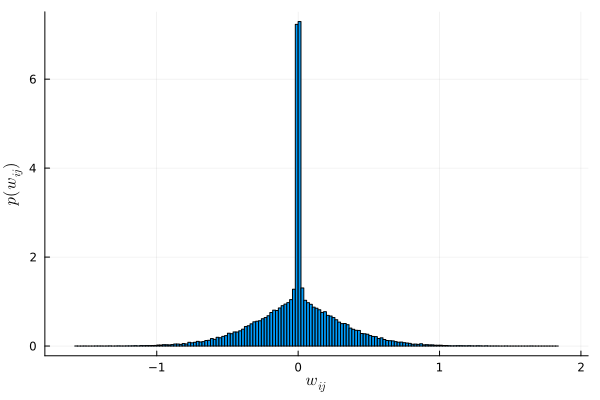

In [136]:
using LaTeXStrings
weights = vec(RBM(rbm).w)
histogram(weights , normalize=:pdf, legend=false)
xlabel!(L"w_{ij}")
ylabel!(L"p(w_{ij})")

In quadratic case: 
$E_{eff-interaction} = -1/2 \sum_{i,j}\left( \sum_{\mu} w_{i\mu} w_{j\mu}\right)v_iv_j \rightarrow  J_{ij}= \sum_{\mu} w_{i\mu} w_{j\mu}$

Even though we are not in gaussian case, let's explore $J_{ij}$.

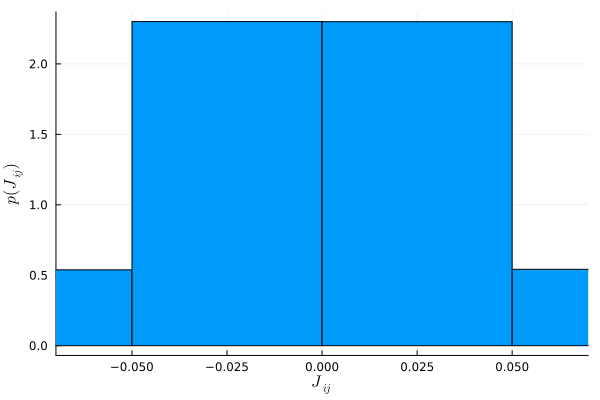

In [137]:
w_shape = size(RBM(rbm).w) 
w = reshape(RBM(rbm).w, (w_shape[1]*w_shape[2],w_shape[3]))
J = vec(w*transpose(w))
histogram(J , normalize=:pdf, legend=false, xlim=(-0.07,0.07))
xlabel!(L"J_{ij}")
ylabel!(L"p(J_{ij})")


# Sampling a Representation of the Sequences

In [138]:
import RestrictedBoltzmannMachines
hidden_data = zeros(n_hidden, data_shape[3])
for i in 1:data_shape[3]
    hidden_data[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm, data_hits[:,:,i]) 
end


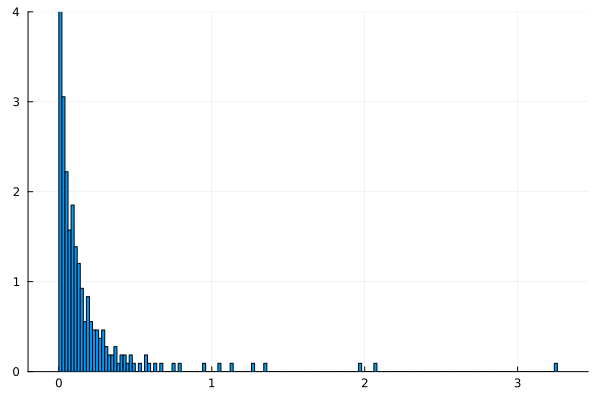

In [139]:
hidden_cov = cov(hidden_data, dims=2)
h_cov_eigenval = eigvals(hidden_cov)
h_expl_ratio = h_cov_eigenval/sum(h_cov_eigenval)
h_ort_trasf = eigvecs(hidden_cov)
h_cov_eigenval = set_negative_to_zero(cov_eigenval)
histogram(h_cov_eigenval, normalize=:pdf, legend=false, ylim=(0,4))


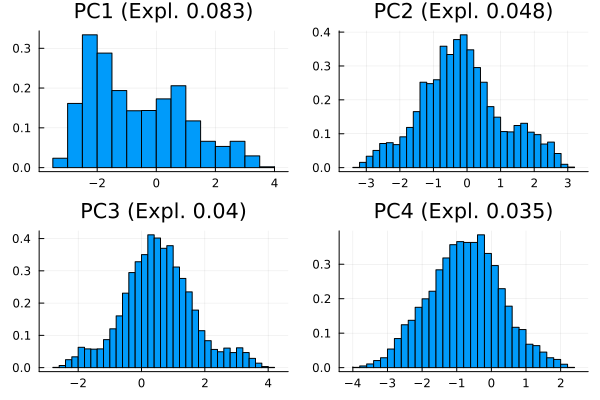

In [140]:
hidden_data_rot = transpose(h_ort_trasf)*hidden_data
hpc1 = hidden_data_rot[end, :]
hp1=histogram(hpc1, normalize=:pdf, title=("PC1 (Expl. $(round(h_expl_ratio[end], digits=3)))"))


hpc2 = hidden_data_rot[end-1, :]
hp2=histogram(hpc2, normalize=:pdf, title=("PC2 (Expl. $(round(h_expl_ratio[end-1], digits=3)))"))

hpc3 = hidden_data_rot[end-2, :]
hp3=histogram(hpc3, normalize=:pdf, title=("PC3 (Expl. $(round(h_expl_ratio[end-2], digits=3)))"))

hpc4 = hidden_data_rot[end-3, :]
hp4=histogram(hpc4, normalize=:pdf, title=("PC4 (Expl. $(round(h_expl_ratio[end-3], digits=3)))"))


plot(hp1, hp2, hp3, hp4, layout=(2,2), legend=false)

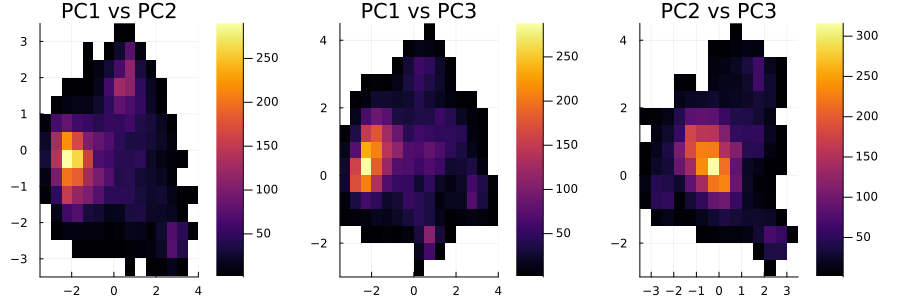

In [141]:
p1=histogram2d(hpc1, hpc2, title="PC1 vs PC2")
p2=histogram2d(hpc1, hpc3, title="PC1 vs PC3")
p3=histogram2d(hpc2, hpc3, title="PC2 vs PC3")

plot(p1, p2, p3, layout=(1,3), legend=false, size=(900,300))

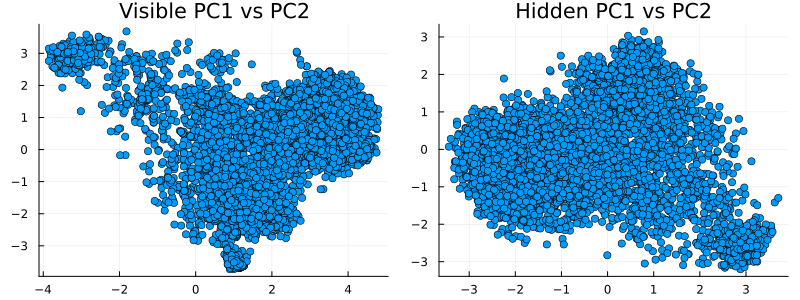

In [142]:
p1 = scatter(pc1, pc2, title="Visible PC1 vs PC2", legend=false)
p2 = scatter(hpc1, hpc2, title="Hidden PC1 vs PC2", legend=false)

plot(p1, p2, layout=(1,2), legend=false, size=(800,300))

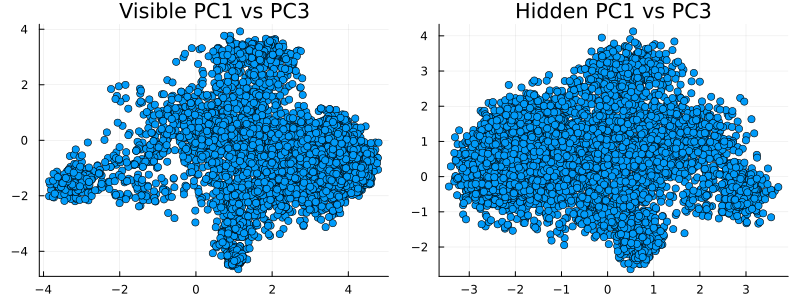

In [143]:
p1 = scatter(pc1, pc3, title="Visible PC1 vs PC3", legend=false)
p2 = scatter(hpc1, hpc3, title="Hidden PC1 vs PC3", legend=false)

plot(p1, p2, layout=(1,2), legend=false, size=(800,300))

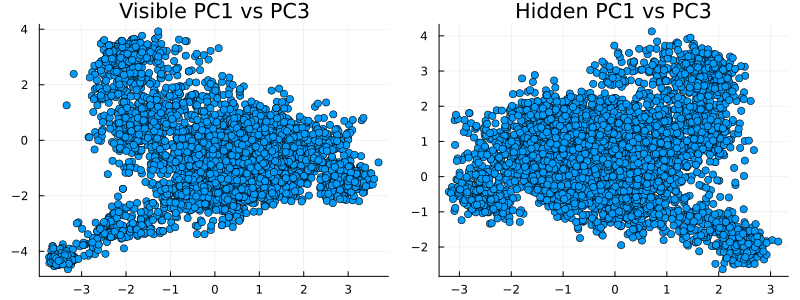

In [144]:
p1 = scatter(pc2, pc3, title="Visible PC2 vs PC3", legend=false)
p2 = scatter(hpc2, hpc3, title="Hidden PC2 vs PC3", legend=false)

plot(p1, p2, layout=(1,2), legend=false, size=(800,300))